['QUEMA_TORNAVACAS_1',
 'QUEMA_TORNAVACAS_2_Camino',
 'QUEMA_TORNAVACAS_3_faja_Camino_LA_CAMPANA',
 'QUEMA_TORNAVACAS_4',
 'QUEMA_TORNAVACAS_5_Entre_rios',
 'QUEMA_TORNAVACAS_6_Pared_EL_Cardal_La_Campana',
 'quema_tornavacas_perimetro_ccaa1',
 'quema_tornavacas_perimetro_ccaa2']

[271930.0146281791, 4462164.329197569, 272517.860780732, 4462437.371351101]

0    MULTIPOLYGON (((272485.546 4462262.205, 272440...
Name: geom, dtype: geometry


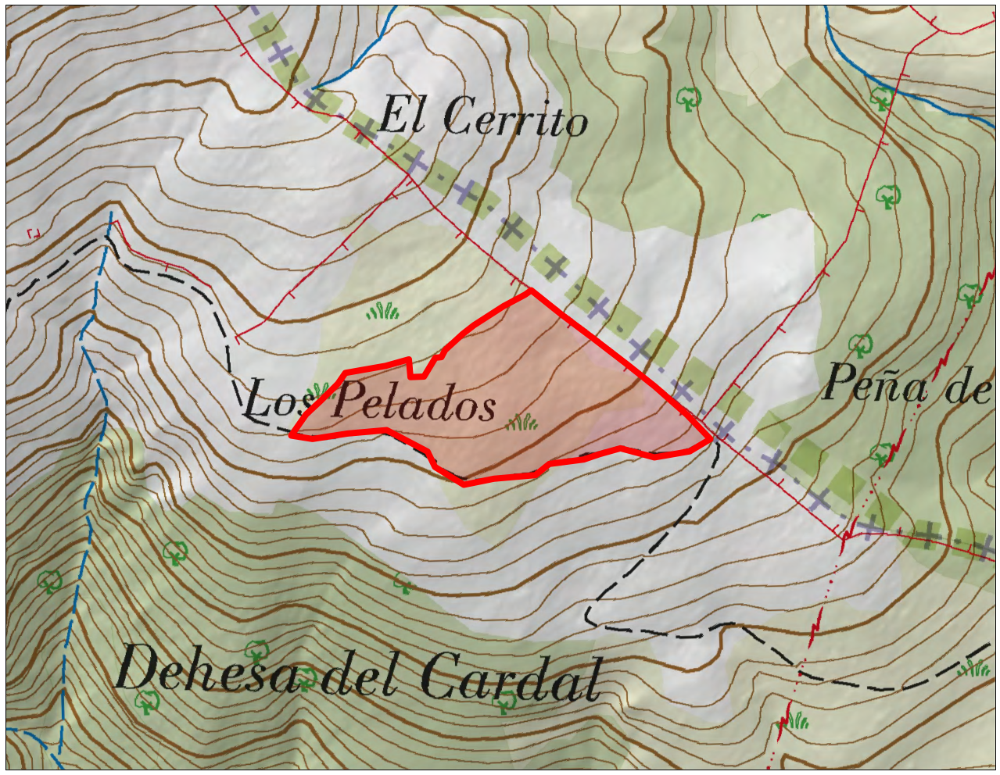

[271804.23252666736, 4462114.344469768, 272527.31469738914, 4462364.815905904]

0    MULTIPOLYGON (((272486.551 4462208.686, 272453...
Name: geom, dtype: geometry


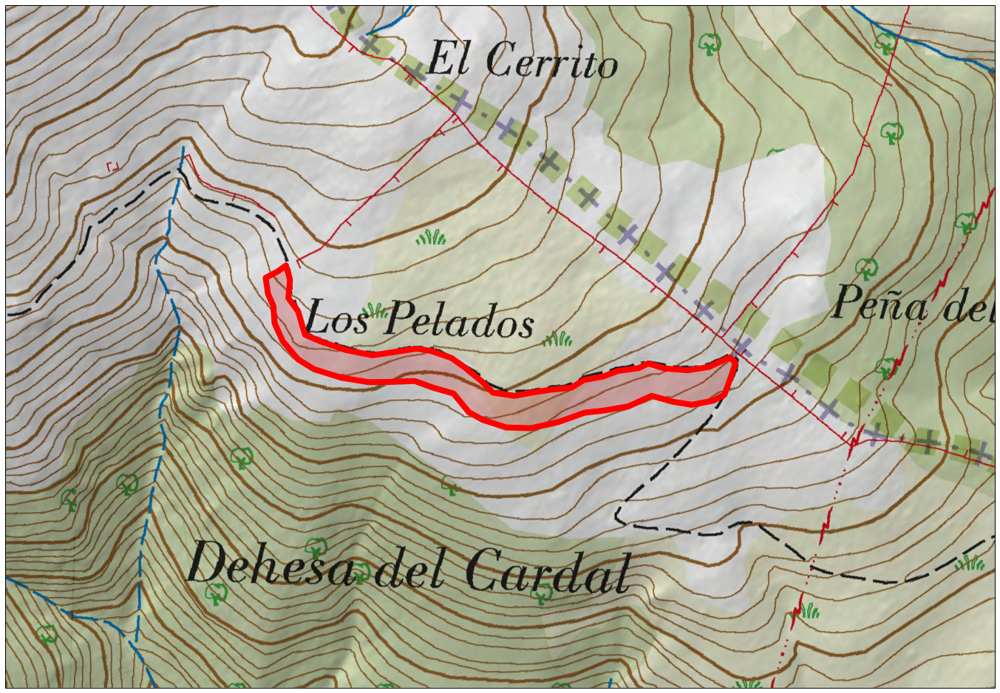

[271666.7469584382, 4462359.2038435405, 271830.7836256949, 4462480.2816253025]

0    MULTIPOLYGON (((271824.706 4462385.101, 271815...
Name: geom, dtype: geometry


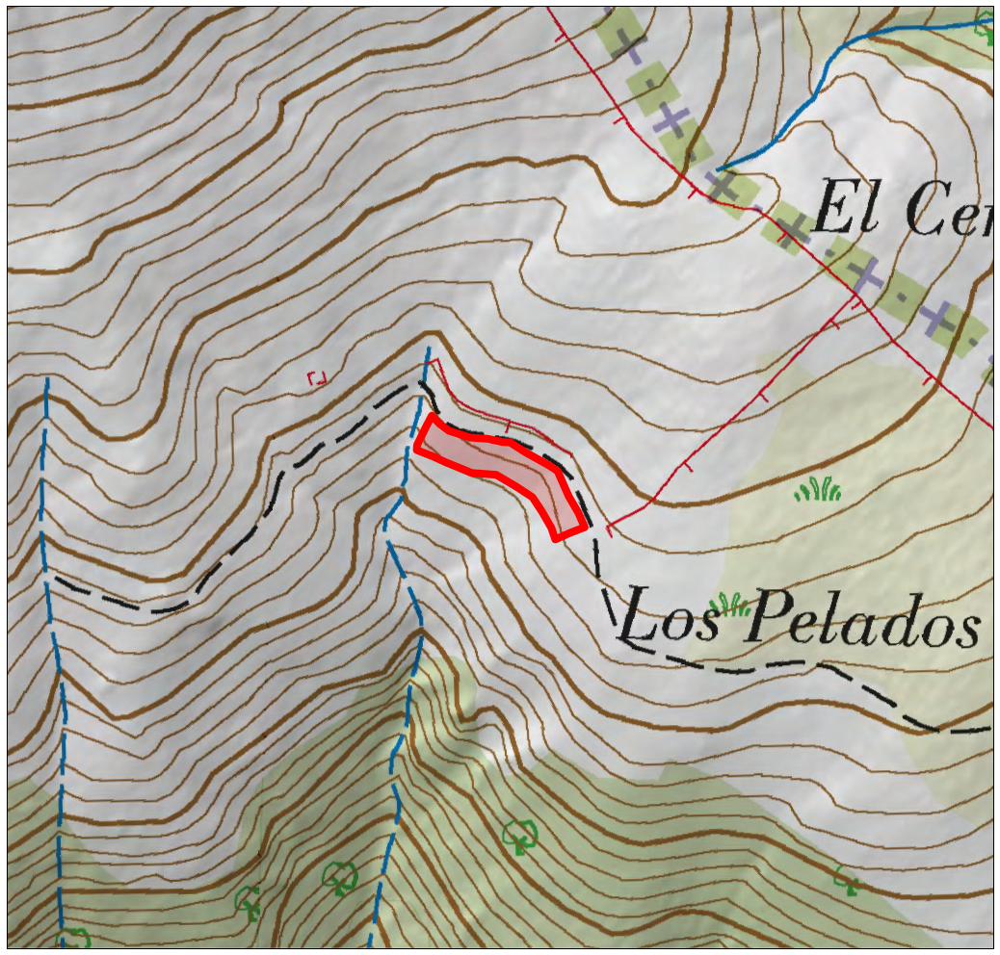

[271248.41374599305, 4462250.566867406, 271657.85306544846, 4462504.208692548]

0    MULTIPOLYGON (((271655.140 4462504.209, 271634...
Name: geom, dtype: geometry


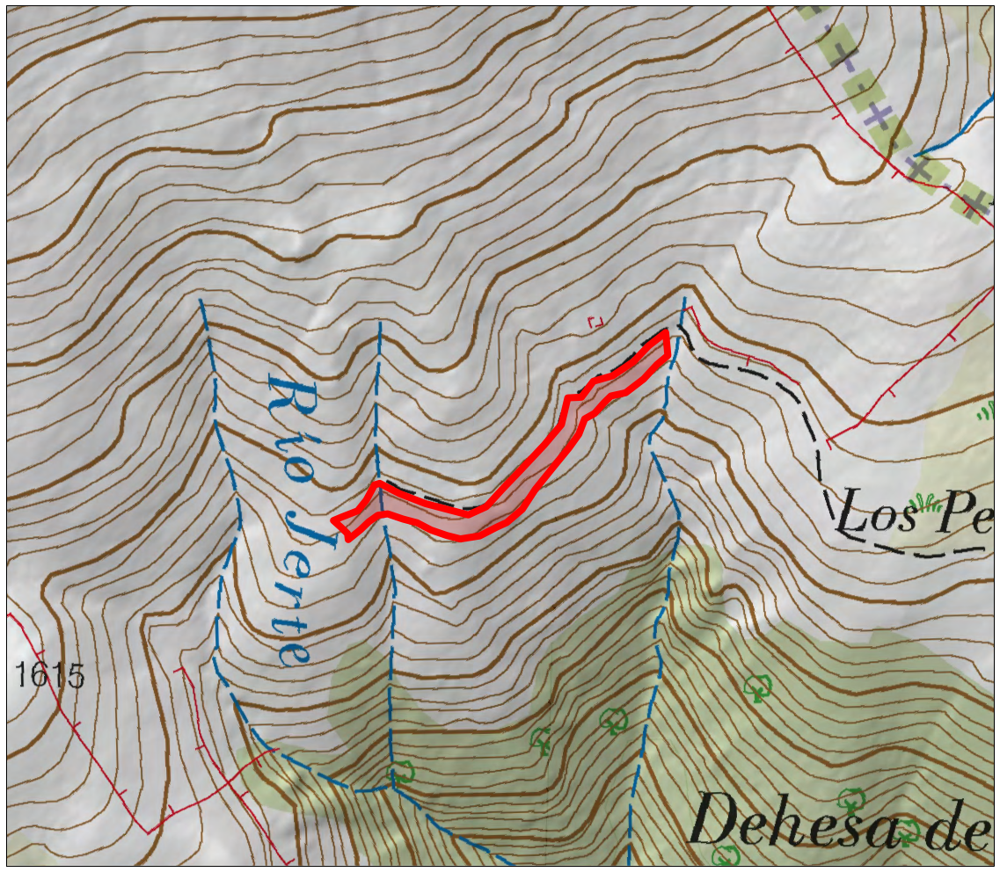

[270883.0303763908, 4462191.467589574, 271179.6220938151, 4462317.546322618]

0    MULTIPOLYGON (((270883.030 4462212.138, 270897...
Name: geom, dtype: geometry


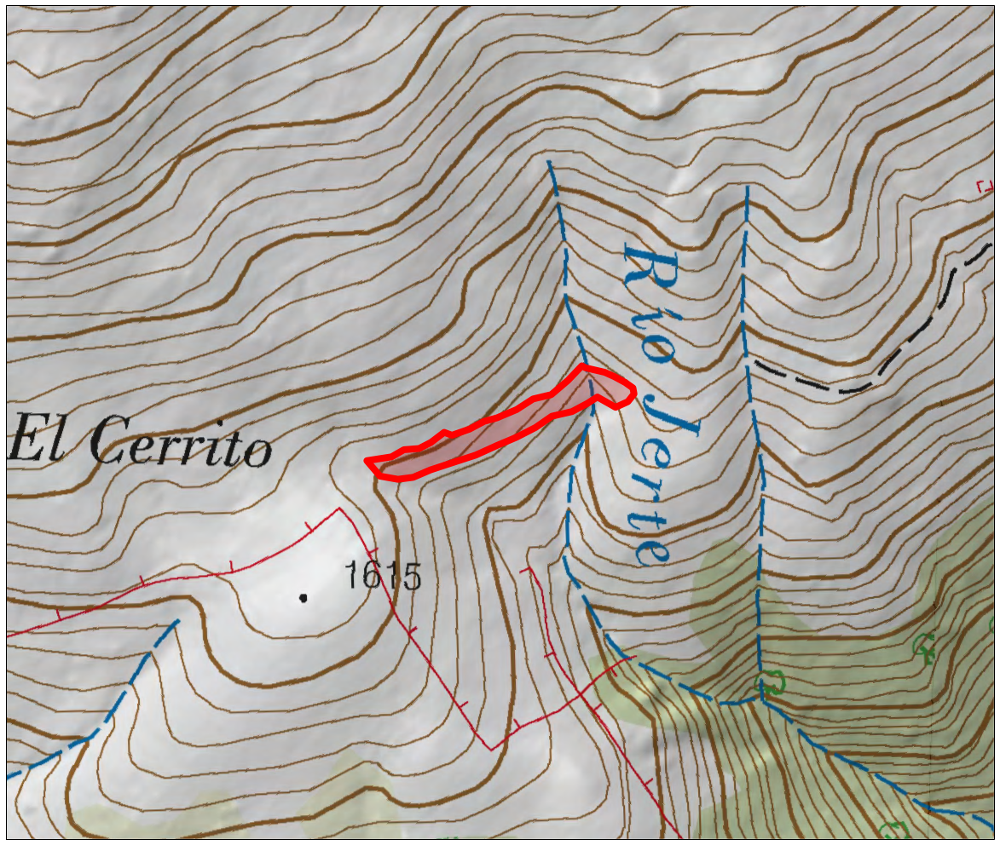

[269931.4049284329, 4461861.57364751, 270648.75510388124, 4462116.210439299]

0    MULTIPOLYGON (((270620.130 4462116.210, 270598...
Name: geom, dtype: geometry


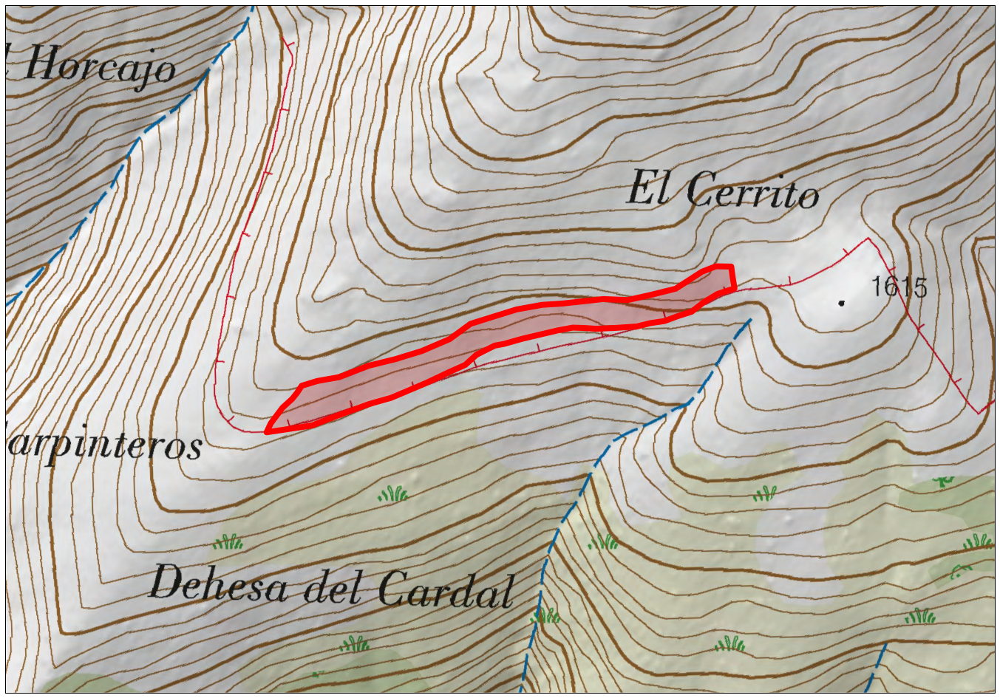

[272109.6176786709, 4462409.432581736, 272263.66021074844, 4462540.869121829]

0    MULTIPOLYGON (((272231.759 4462418.849, 272249...
Name: geom, dtype: geometry


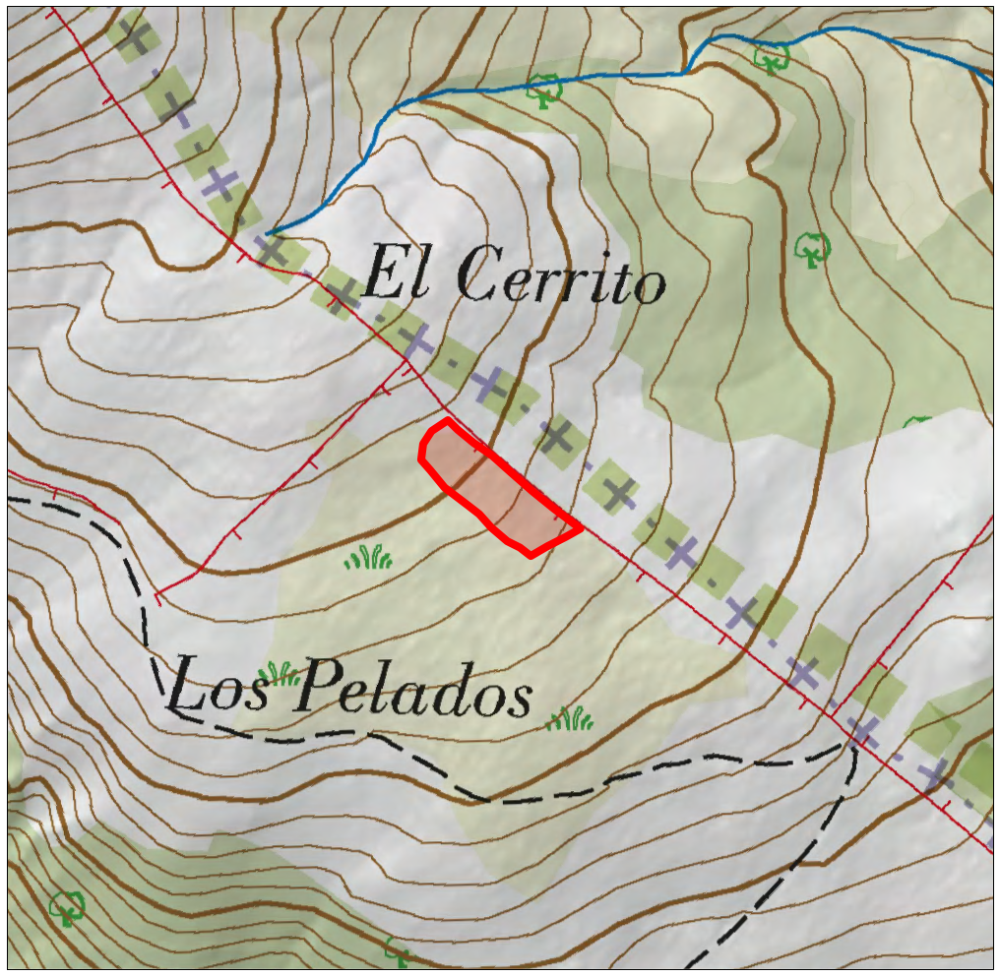

[271125.38314875215, 4463529.076533477, 271254.4974355529, 4463641.881111967]

0    MULTIPOLYGON (((271162.738 4463641.881, 271149...
1    MULTIPOLYGON (((271227.646 4463523.923, 271231...
2    MULTIPOLYGON (((271319.648 4463413.251, 271305...
Name: geom, dtype: geometry


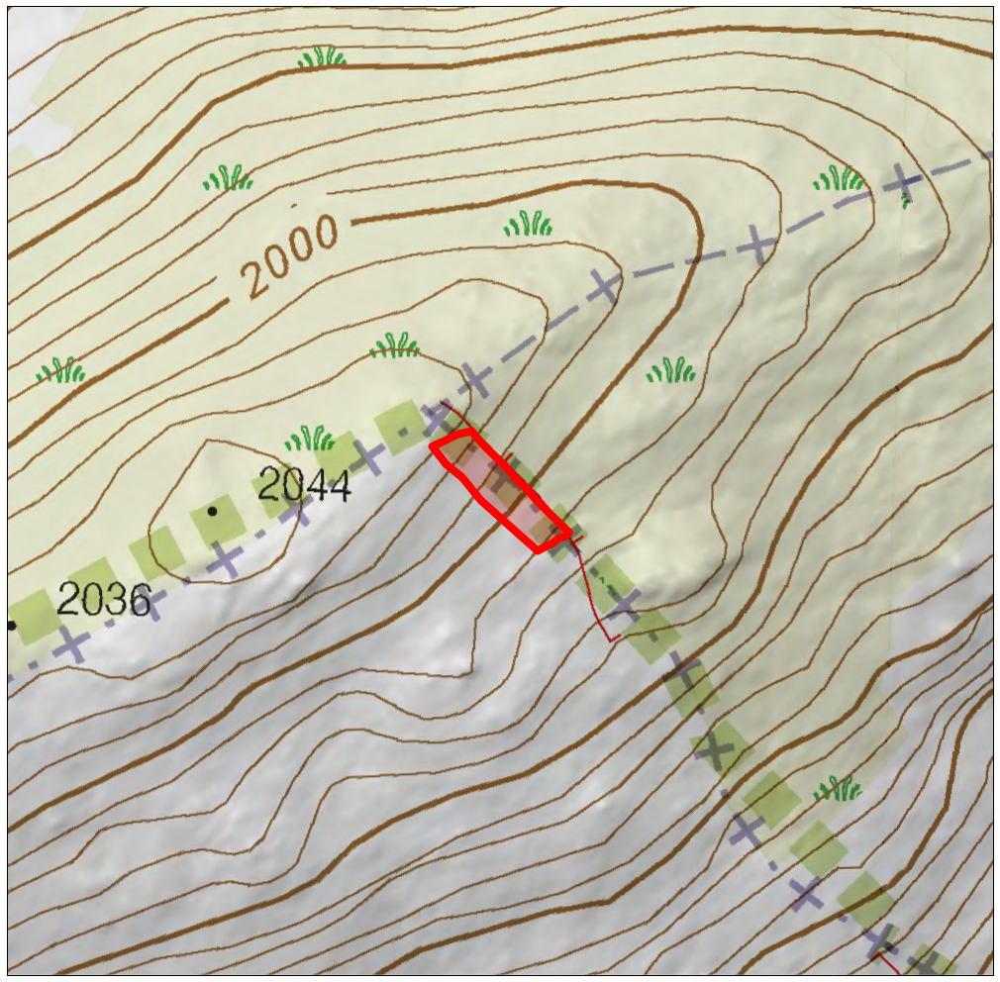

[271227.64574677206, 4463401.519363694, 271308.32135533576, 4463544.7254553465]

0    MULTIPOLYGON (((271162.738 4463641.881, 271149...
1    MULTIPOLYGON (((271227.646 4463523.923, 271231...
2    MULTIPOLYGON (((271319.648 4463413.251, 271305...
Name: geom, dtype: geometry


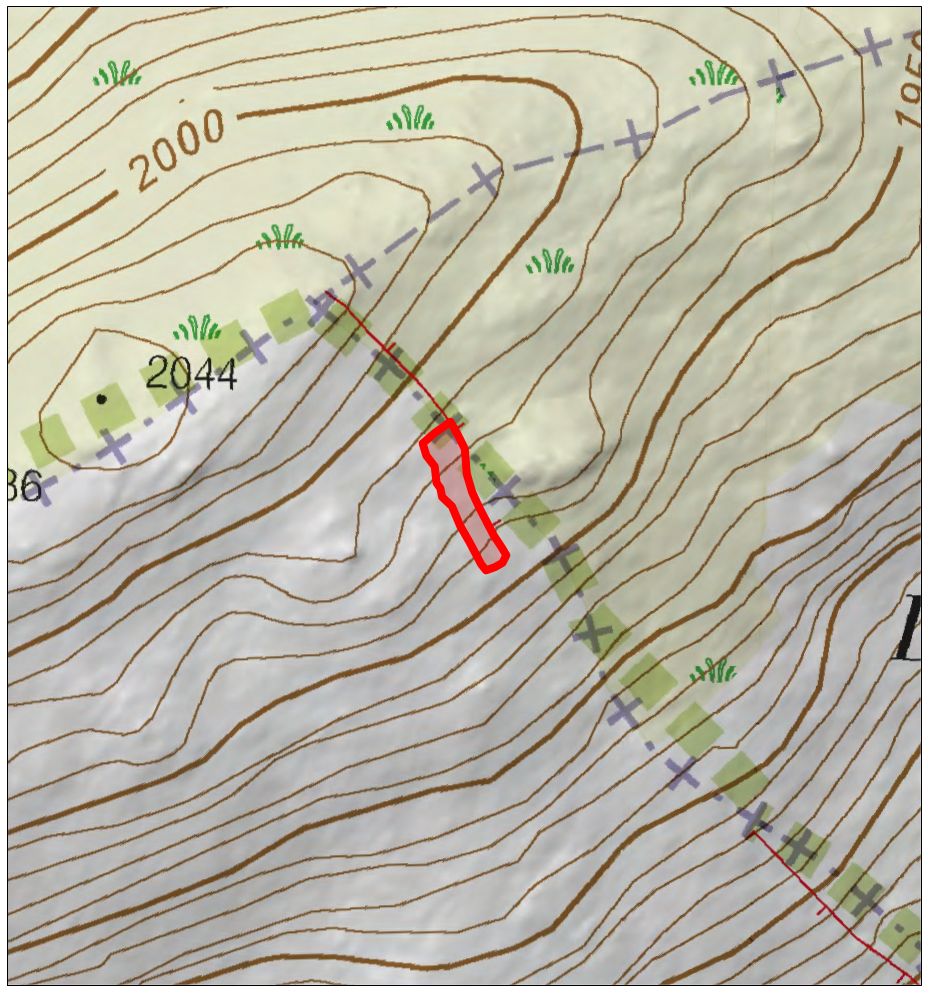

[271292.3414323467, 4463246.049368149, 271422.34080289776, 4463413.250995472]

0    MULTIPOLYGON (((271162.738 4463641.881, 271149...
1    MULTIPOLYGON (((271227.646 4463523.923, 271231...
2    MULTIPOLYGON (((271319.648 4463413.251, 271305...
Name: geom, dtype: geometry


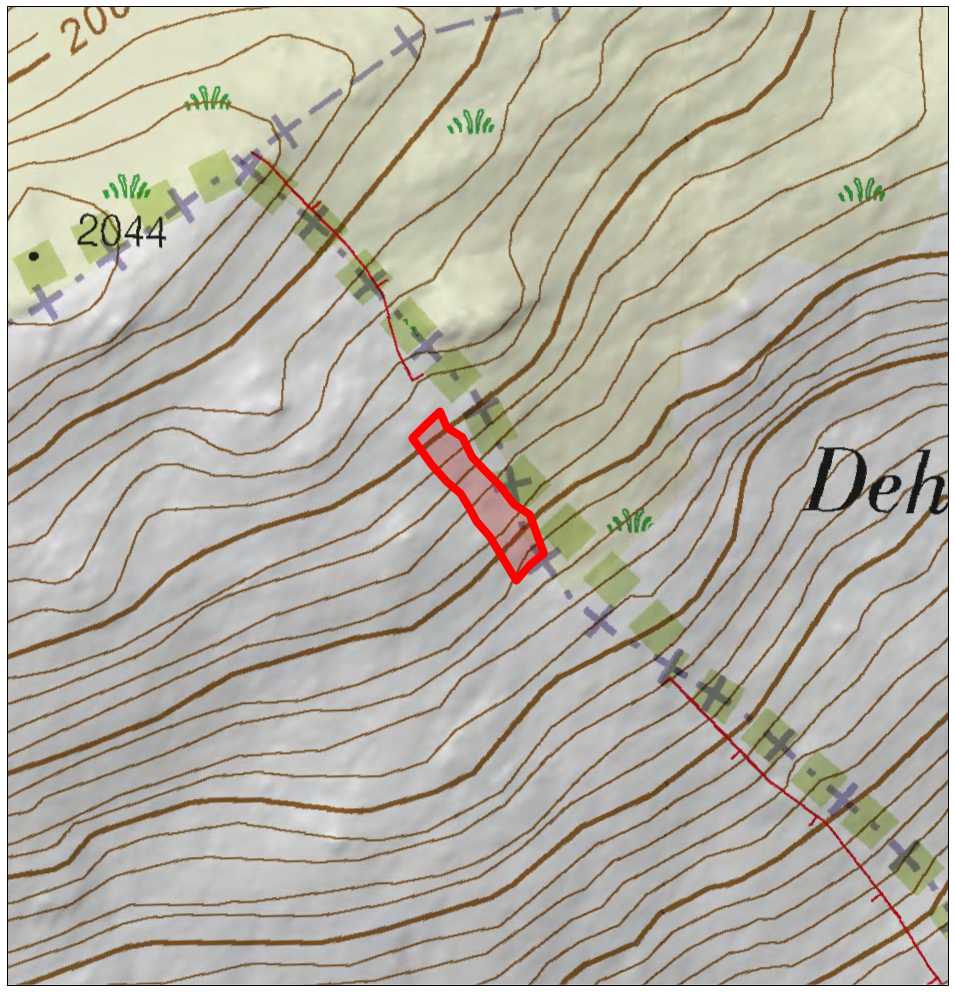

In [17]:
import psycopg2
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
from config import config
from osgeo import gdal
import matplotlib.patches as mpatches
import cartopy.crs as ccrs

params = config()
conn = psycopg2.connect(**params)

a = !ls ../FINALES/PARCELAS/TORNAVACAS/*shp
parcelas = list(map(lambda x: x.split('/')[-1].split('.')[0], a))

proj = ccrs.epsg('25830')
buffer = 400

display(parcelas)
for p in parcelas:
    parcela = gpd.read_postgis('select st_transform(geom, 25830) as geom from {}'.format(p), conn)
    for g in parcela.geom:
        fig = plt.figure(figsize=(24,18))
        ax = plt.axes(projection=proj)
        lim = list(g.bounds)
        display(lim)
        ax.set_extent([lim[0] - buffer,lim[2] + buffer, lim[1] - buffer, lim[3] + buffer], crs=ccrs.epsg('25830'))
        print(parcela.geom)
#         ax.add_wms(wms='https://www.ign.es/wms-inspire/pnoa-ma', layers=['OI.OrthoimageCoverage'])

        ax.add_wms(wms='https://www.ign.es/wms-inspire/mapa-raster', layers=['mtn_rasterizado'])
    
#         CURVAS DE NIVEL

#         gdal_data = gdal.Open('../BRUTOS/mdt/mdt_combinado_.tif')
#         gdal.Translate('static/prueba.tif', gdal_data, projWin = (lim[0] - buffer, lim[3] + buffer, lim[2] + buffer, lim[1] - buffer))

#         mdt = gdal.Open('static/prueba.tif')

#         data_array = mdt.ReadAsArray().astype(np.float)
#         mdt_array = np.flipud(data_array)

#         plt.subplot(ax)
#         ax.contour(mdt_array, cmap='terrain', levels = list(range(0,2500, 2)), 
#                    extent=(lim[0] - buffer, lim[2] + buffer, lim[1] - buffer, lim[3] + buffer))   
        
#         PARCELA

        ax.add_geometries(g, facecolor=(0.8,0,0,0.2), edgecolor='red', linewidth=8, crs=ccrs.epsg('25830'))
    
        fig.savefig('static/images/parcela_topo_{}'.format(p), bbox_inches='tight', pad_inches=0)
        plt.show()
        plt.close(fig)
conn.close()